In [1]:
import ast
import glob
import json
import os
import re
import shutil

import albumentations as A
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
from IPython.core.interactiveshell import InteractiveShell
from PIL import Image
from torchvision.ops import box_iou
from tqdm import tqdm

InteractiveShell.ast_node_interactivity = "all"
import seaborn as sns
from IPython.display import clear_output

In [2]:
def plot_bboxes(img, bboxes):
    try:
        img_h, img_w = img.shape[:2]
    except:
        img_w, img_h = img.size
    fig, ax = plt.subplots(1, 1, figsize=(20, 12))
    ax.imshow(img)
    for i in range(len(bboxes)):
        x_min, y_min, width, height = (
            bboxes[i]["x"],
            bboxes[i]["y"],
            bboxes[i]["width"],
            bboxes[i]["height"],
        )
        rect = plt.Rectangle(
            [x_min, y_min], width, height, ec="r", fc="none", lw=2.0
        )
        ax.add_patch(rect)
    plt.show();

In [3]:
TRAIN_DF_PART = "/app/_data/tensorflow-great-barrier-reef/train.csv"

In [4]:
df = pd.read_csv(TRAIN_DF_PART)
df["img_path"] = (
    "/app/_data/tensorflow-great-barrier-reef/train_images/video_"
    + df.video_id.astype("str")
    + "/"
    + df.video_frame.astype("str")
    + ".jpg"
)
df["annotations"] = df["annotations"].apply(lambda x: ast.literal_eval(x))
df["len_annotation"] = df["annotations"].str.len()
df["image_id"] = df["image_id"].str.replace("-", "_", regex=True)
df["new_img_path"] = f"/app/_data/images/" + df["image_id"] + ".jpg"
df["label"] = df["len_annotation"].apply(lambda x: 0 if x == 0 else 1)
df["no_label"] = df["len_annotation"].apply(lambda x: True if x == 0 else False)

In [5]:
df["label_change"] = df["label"] & df["no_label"].shift(1) & df["no_label"].shift(
    2
) | df["no_label"] & df["label"].shift(1) & df["label"].shift(2)
df["sequense_change"] = df["sequence"] != df["sequence"].shift(1)
df["start_subseq"] = df["sequense_change"] | df["label_change"]
df.loc[df.index[-1], "start_subseq"] = True
df["start_subseq"].sum()

start_idx = 0
for subsequence_id, end_idx in enumerate(df[df["start_subseq"]].index):
    df.loc[start_idx:end_idx, "subsequence_id"] = subsequence_id
    start_idx = end_idx

df["subsequence_id"] = df["subsequence_id"].astype(int)
df["subsequence_id"].nunique()

138

137

In [6]:
for i in range(3):
    print(
        f'Video id = {i}, {df[df["video_id"] == i]["len_annotation"].values.sum()} annotations on {df[df["video_id"] == i]["label"].values.sum()} images'
    )

Video id = 0, 3065 annotations on 2143 images
Video id = 1, 6384 annotations on 2099 images
Video id = 2, 2449 annotations on 677 images


In [7]:
df.query("len_annotation != 0")["sequence"].unique().shape[0]

17

In [8]:
set(df["sequence"].unique()) - set(df.query("len_annotation != 0")["sequence"].unique())

{29424, 37114, 44160}

# extract photos to gallery

In [9]:
# for seq in tqdm(df["subsequence_id"].unique()):
#     ndf = df.query("subsequence_id==@seq and len_annotation != 0").reset_index(drop=True)
#     for ix in range(0, len(ndf), 3):
#         img_path = ndf.loc[ix, "img_path"]
#         img = Image.open(img_path)
#         img_name = f'{ndf.loc[ix, "image_id"]}_{seq}.jpg'
#         img = img.resize([640, 360])
#         if not os.path.exists(f'/app/_data/img_lenovo/{ndf.loc[ix, "video_id"]}_{seq}'):
#             os.makedirs(f'/app/_data/img_lenovo/{ndf.loc[ix, "video_id"]}_{seq}')
#         img.save(f'/app/_data/img_lenovo/{ndf.loc[ix, "video_id"]}_{seq}/{img_name}')
# shutil.make_archive('reef_labeled', 'zip', '/app/_data/img_lenovo/')
# shutil.rmtree('/app/_data/img_lenovo/')

# labels - visual study

In [10]:
paths = [
    "/home/nata/kaggle/reef/reef_labeled/water_reef/train/2_22643/",
    "/home/nata/kaggle/reef/reef_labeled/water_reef/train/1_60754/",
    "/home/nata/kaggle/reef/reef_labeled/water/train/0_53708/",
    "/home/nata/kaggle/reef/reef_labeled/reef/train/1_8503/",
    "/home/nata/kaggle/reef/reef_labeled/water_reef/1_18048/",
    "/home/nata/kaggle/reef/reef_labeled/water_reef/2_26651/",
    "/home/nata/kaggle/reef/reef_labeled/water_reef/1_15827/",
    "/home/nata/kaggle/reef/reef_labeled/water_reef/2_29859/",
    "/home/nata/kaggle/reef/reef_labeled/water/0_59337/",
    "/home/nata/kaggle/reef/reef_labeled/water/0_8399/",
    "/home/nata/kaggle/reef/reef_labeled/water/0_45518/",
    "/home/nata/kaggle/reef/reef_labeled/water/0_35305/",
    "/home/nata/kaggle/reef/reef_labeled/water/0_45015/",
    "/home/nata/kaggle/reef/reef_labeled/water/1_17665/",
    "/home/nata/kaggle/reef/reef_labeled/water/0_40258/",
    "/home/nata/kaggle/reef/reef_labeled/water/0_996/",
    "/home/nata/kaggle/reef/reef_labeled/reef/1_60510/",
]
no_bboxes = {29424: "water_reef", 37114: "reef", 44160: "water"}
paths = [x.replace("/home/nata/kaggle/reef/reef_labeled/", "") for x in paths]

In [11]:
train_dict = {}
for x in paths:
    x = x.split("/")[:-1]
    if len(x) == 3:
        train_dict[int(x[-1].split("_")[-1])] = [x[0], x[1]]
    else:
        train_dict[int(x[-1].split("_")[-1])] = [x[0], "all"]

In [12]:
for k in no_bboxes:
    train_dict[k] = [no_bboxes[k], "all"]

In [13]:
train_dict

{22643: ['water_reef', 'train'],
 60754: ['water_reef', 'train'],
 53708: ['water', 'train'],
 8503: ['reef', 'train'],
 18048: ['water_reef', 'all'],
 26651: ['water_reef', 'all'],
 15827: ['water_reef', 'all'],
 29859: ['water_reef', 'all'],
 59337: ['water', 'all'],
 8399: ['water', 'all'],
 45518: ['water', 'all'],
 35305: ['water', 'all'],
 45015: ['water', 'all'],
 17665: ['water', 'all'],
 40258: ['water', 'all'],
 996: ['water', 'all'],
 60510: ['reef', 'all'],
 29424: ['water_reef', 'all'],
 37114: ['reef', 'all'],
 44160: ['water', 'all']}

# Images example

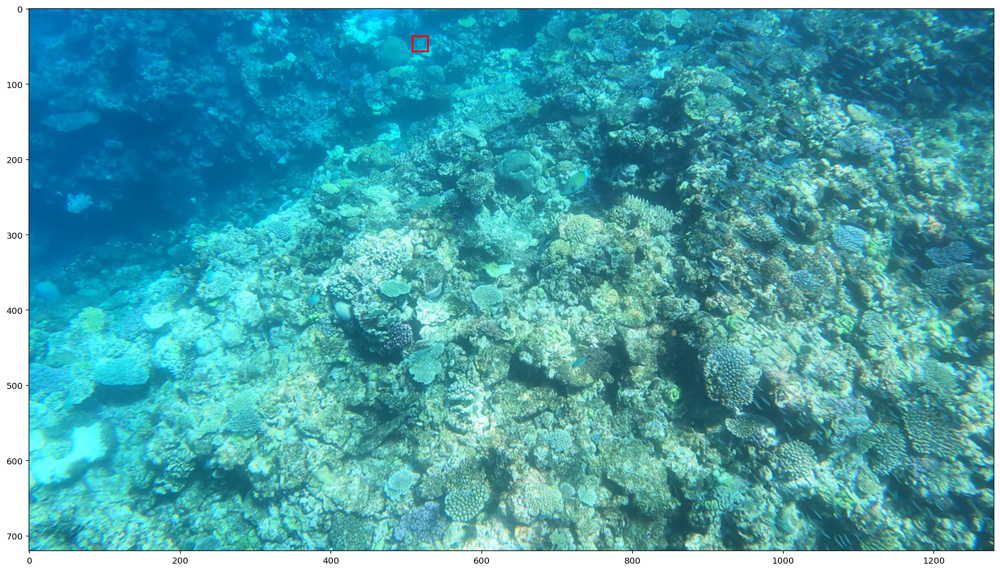

In [14]:
ix = df.query("len_annotation!=0").sample().index[0]
img = Image.open(df.loc[ix, "img_path"])
img_h, img_w = np.array(img).shape[:2]
annotations = df.loc[ix, "annotations"]
plot_bboxes(img, annotations)

# Statistics

In [15]:
xmins, ymins, ws, hs, intersections = [], [], [], [], []
for ix in tqdm(df.index.tolist()):
    annotations = df.loc[ix, "annotations"]
    if len(annotations) != 0:
        bboxes = []
        w = []
        h = []
        for a in range(len(annotations)):
            xmin = annotations[a]["x"]
            ymin = annotations[a]["y"]
            width = annotations[a]["width"]
            height = annotations[a]["height"]
            w.append(width)
            h.append(height)
            bboxes.append([xmin, ymin, xmin + width, ymin + height])
            for l, p in zip([xmins, ymins, ws, hs], [xmin, ymin, width, height]):
                l.append(p)
        iou_matrix = box_iou(
            torch.Tensor(np.array(bboxes)), torch.Tensor(np.array(bboxes))
        ).numpy()
        iou_matrix = np.where(iou_matrix.flatten() == 1, 0, iou_matrix.flatten())
        if iou_matrix.max() != 0:
            intersections.extend(list(set([x for x in iou_matrix if x > 0])))
        df.loc[ix, "width_max"] = np.max(w)
        df.loc[ix, "width_min"] = np.min(w)
        df.loc[ix, "height_max"] = np.max(h)
        df.loc[ix, "height_min"] = np.min(h)
        df.loc[ix, "width_mean"] = np.mean(w)
        df.loc[ix, "height_mean"] = np.mean(h)

100% 23501/23501 [00:10<00:00, 2242.05it/s] 


In [16]:
df.groupby("video_id")[
    [
        "len_annotation",
        "label",
        "width_max",
        "width_min",
        "height_max",
        "height_min",
        "width_mean",
        "height_mean",
    ]
].agg(["mean"])

,len_annotation,label,width_max,width_min,height_max,height_min,width_mean,height_mean
,mean,mean,mean,mean,mean,mean,mean,mean
video_id,,,,,,,,
0,0.456917,0.319469,52.906673,47.849277,43.892674,39.109193,50.409885,41.524693
1,0.775510,0.254981,55.748928,42.120057,52.522630,40.103383,48.368724,45.791643
2,0.286065,0.079080,47.787297,35.161004,43.242245,32.165436,41.419150,37.717586


In [17]:
xmins = np.array(xmins)
ymins = np.array(ymins)
ws = np.array(ws)
hs = np.array(hs)
intersections = np.array(intersections)
w_h_ratio = ws / hs
areas = ws * hs
xmaxs = xmins + ws
ymaxs = ymins + hs

In [18]:
stat = pd.DataFrame([xmins, ymins, ws, hs, areas, intersections, w_h_ratio]).T
stat.columns = ["xmin", "ymin", "width", "heigh", "area", "intersection", "w_h_ratio"]
stat.describe(percentiles=[0.01, 0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

,xmin,ymin,width,heigh,area,intersection,w_h_ratio
count,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,1090.000000,11898.000000
mean,490.038578,346.267944,47.885443,42.723231,2259.660699,0.085514,1.149492
std,274.052305,185.139016,17.448619,15.379084,1973.017724,0.067108,0.278066
min,0.000000,0.000000,17.000000,13.000000,288.000000,0.000395,0.247788
1%,0.000000,3.970000,22.000000,20.000000,493.700000,0.002066,0.642857
5%,67.000000,50.000000,26.000000,24.000000,676.000000,0.006788,0.807692
10%,143.000000,89.000000,29.000000,26.000000,806.000000,0.013945,0.875000
25%,278.000000,198.000000,35.000000,32.000000,1155.000000,0.035649,0.985294
50%,477.000000,346.000000,45.000000,40.000000,1786.000000,0.072941,1.108108
75%,664.000000,493.750000,57.000000,52.000000,2907.000000,0.120925,1.258065


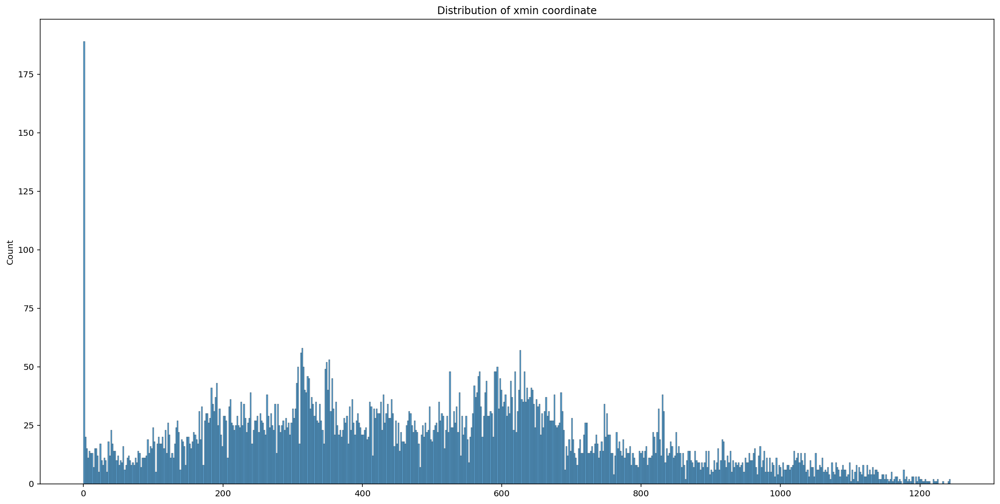

In [19]:
plt.figure(figsize=(20, 10))
plt.title("Distribution of xmin coordinate")
sns.histplot(xmins, bins=1280 // 2)
plt.show();

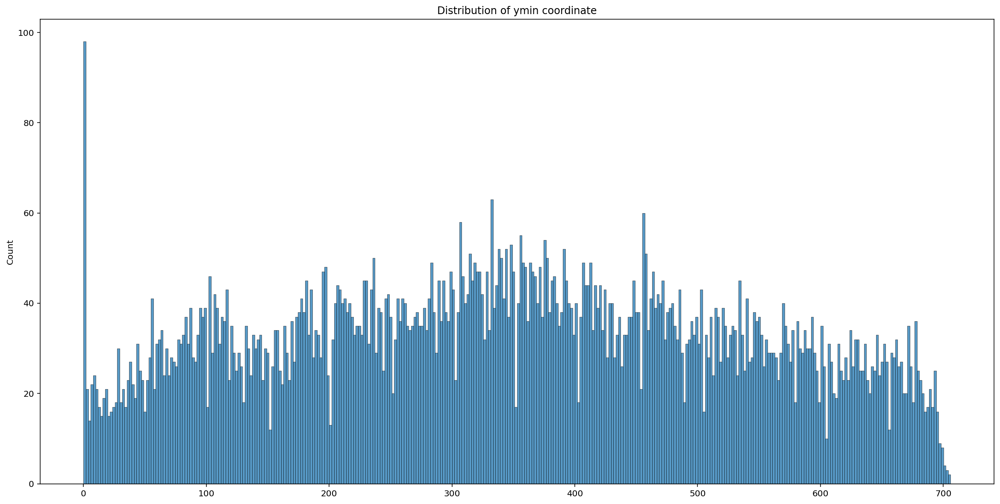

In [20]:
plt.figure(figsize=(20, 10))
plt.title("Distribution of ymin coordinate")
sns.histplot(ymins, bins=720 // 2)
plt.show();

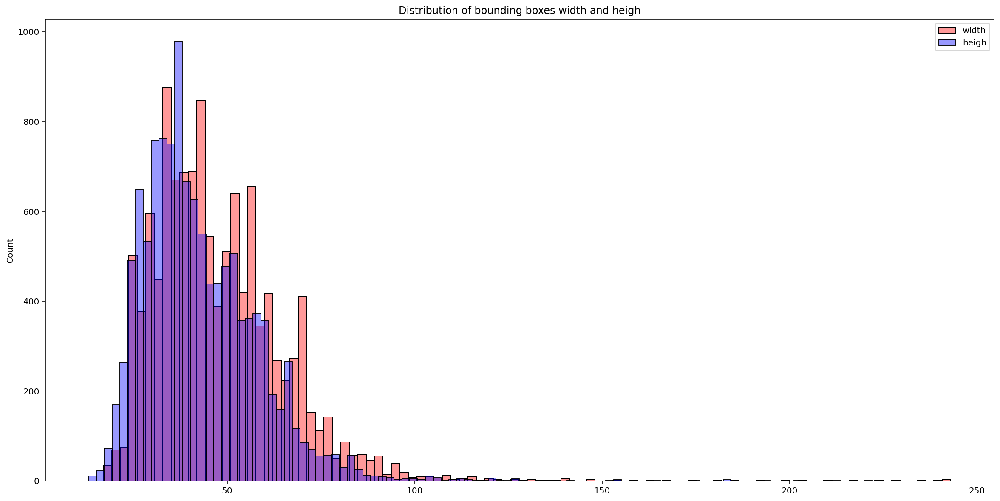

In [21]:
plt.figure(figsize=(20, 10))
plt.title("Distribution of bounding boxes width and heigh")
sns.histplot(ws, bins=100, color="r", label="width", alpha=0.4)
sns.histplot(hs, bins=100, color="b", label="heigh", alpha=0.4)
plt.legend()
plt.show();

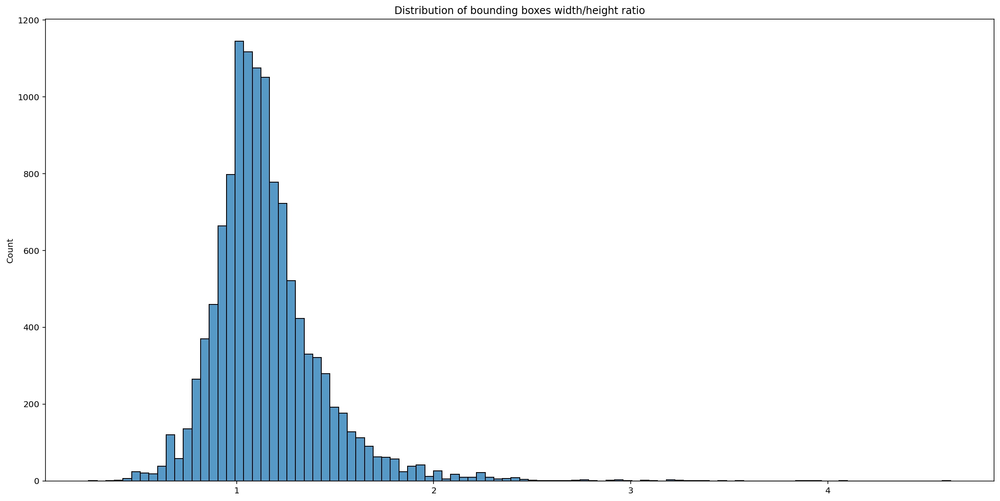

In [22]:
plt.figure(figsize=(20, 10))
plt.title("Distribution of bounding boxes width/height ratio")
sns.histplot(w_h_ratio, bins=100)
plt.show();

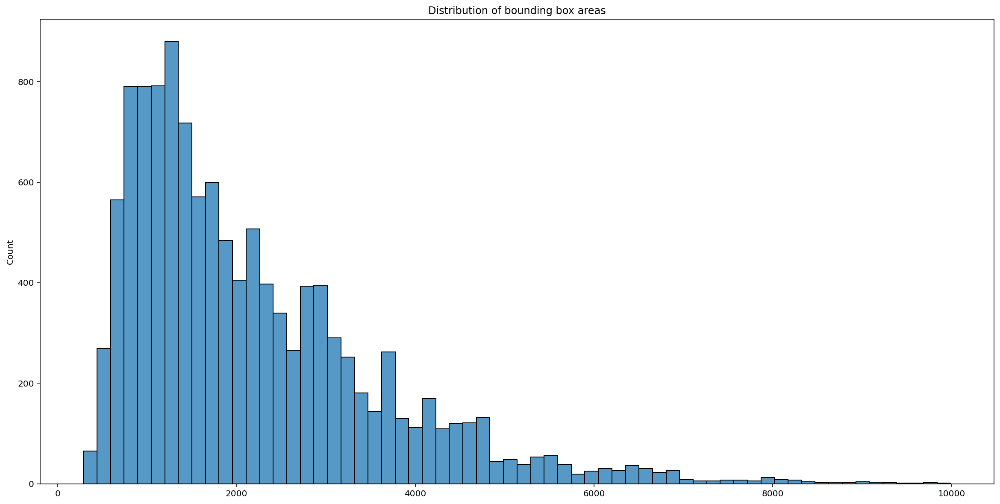

In [23]:
plt.figure(figsize=(20, 10))
plt.title("Distribution of bounding box areas")
sns.histplot(areas[areas < 10000])
plt.show();

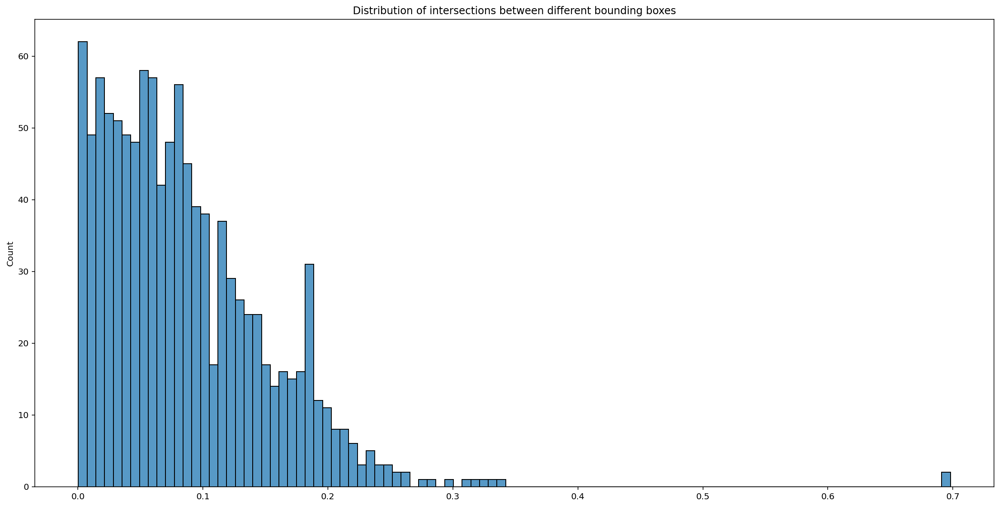

In [24]:
plt.figure(figsize=(20, 10))
plt.title("Distribution of intersections between different bounding boxes")
sns.histplot(intersections, bins=100)
plt.show();

# Images statistics

In [25]:
reds = []
greens = []
blues = []
for img_path in tqdm(glob.glob("/app/_data/tensorflow-great-barrier-reef/*/*/*.jpg")):
    img = np.array(Image.open(img_path))
    reds.append([img[:, :, 0].min(), img[:, :, 0].max()])
    greens.append([img[:, :, 1].min(), img[:, :, 1].max()])
    blues.append([img[:, :, 2].min(), img[:, :, 2].max()])

100% 23501/23501 [10:14<00:00, 38.27it/s]


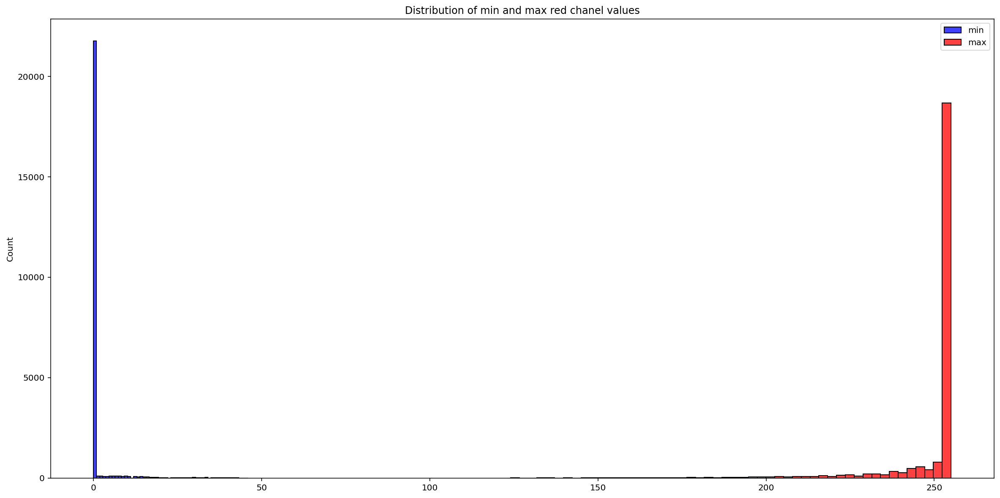

In [26]:
plt.figure(figsize=(20, 10))
plt.title("Distribution of min and max red chanel values")
sns.histplot(np.array(reds)[:, 0], bins=50, color="b", label="min")
sns.histplot(np.array(reds)[:, 1], bins=50, color="r", label="max")
plt.legend()
plt.show();

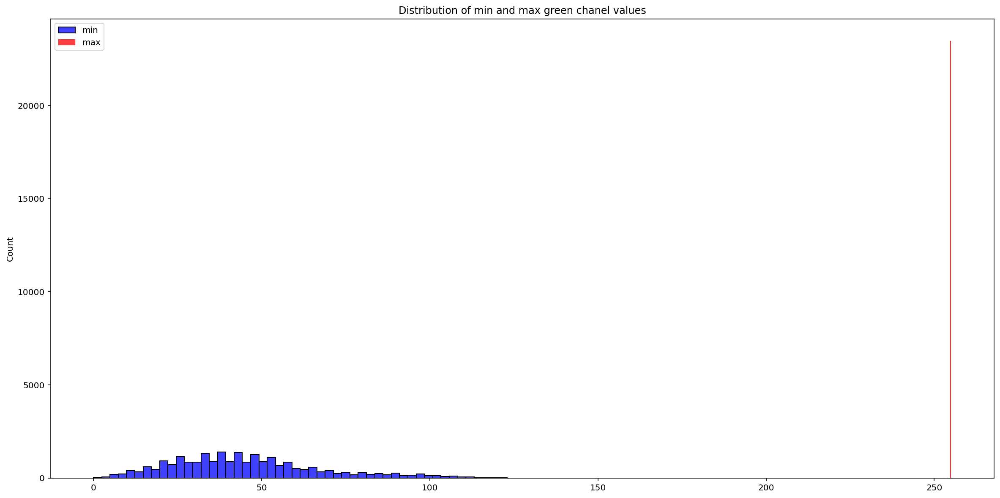

In [27]:
plt.figure(figsize=(20, 10))
plt.title("Distribution of min and max green chanel values")
sns.histplot(np.array(greens)[:, 0], bins=50, color="b", label="min")
sns.histplot(np.array(greens)[:, 1], bins=50, color="r", label="max")
plt.legend()
plt.show();

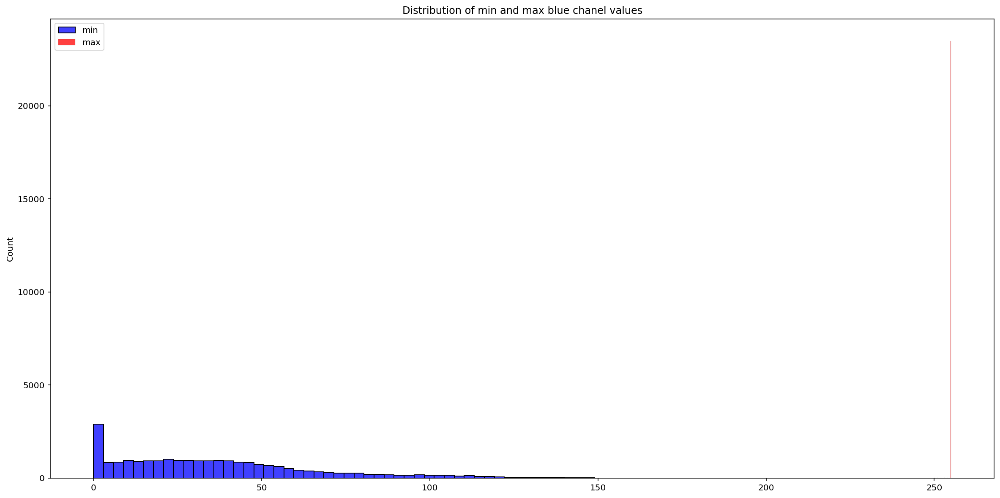

In [28]:
plt.figure(figsize=(20, 10))
plt.title("Distribution of min and max blue chanel values")
sns.histplot(np.array(blues)[:, 0], bins=50, color="b", label="min")
sns.histplot(np.array(blues)[:, 1], bins=50, color="r", label="max")
plt.legend()
plt.show();

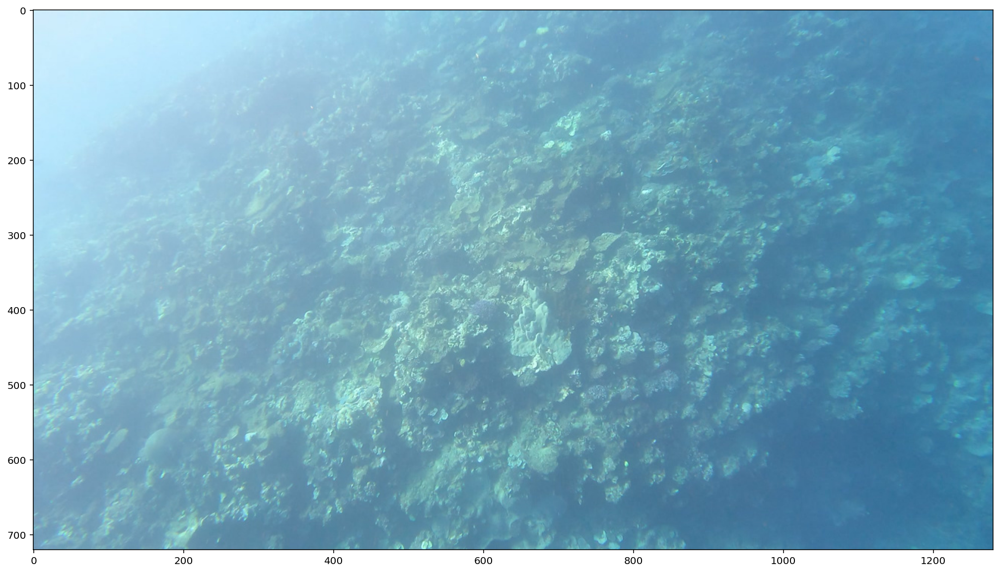

In [29]:
img_path = glob.glob("/app/_data/tensorflow-great-barrier-reef/*/*/*.jpg")[
    np.argmax(np.array(reds)[:, 0])
]
img = np.array(Image.open(img_path))
plt.figure(figsize=(20, 10))
plt.imshow(img)
plt.show();

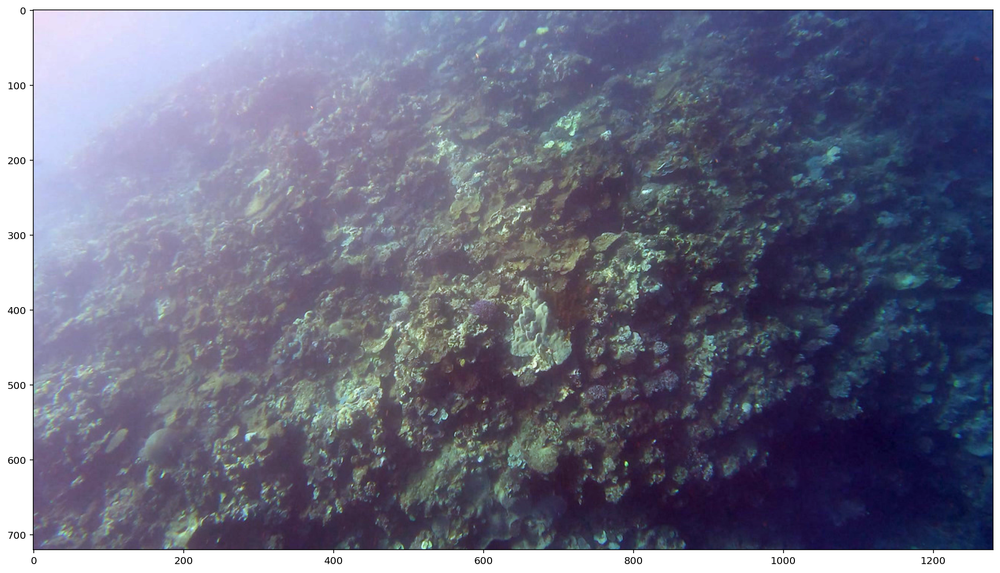

In [30]:
image = img.astype("float").copy()
for i in range(3):
    image[:, :, i] = image[:, :, i] - image[:, :, i].min()
    image[:, :, i] = image[:, :, i] / image[:, :, i].max()
image = np.round(image * 255).astype("uint8")
image = np.clip(image, 0, 255)
plt.figure(figsize=(20, 10))
plt.imshow(image)
plt.show();

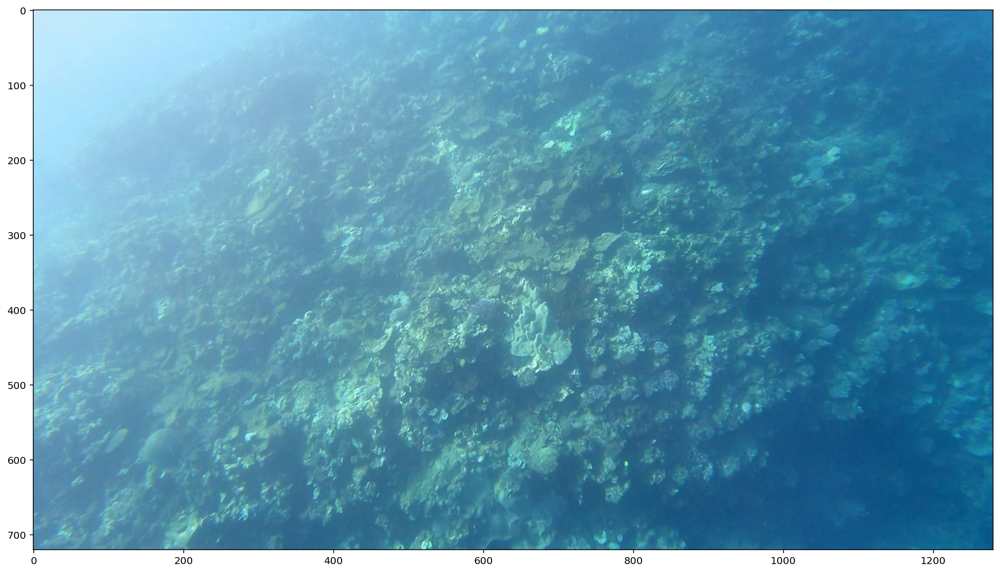

In [31]:
image = img.astype("float").copy()
image = image - image.min()
image = image / image.max()
image = np.round(image * 255).astype("uint8")
image = np.clip(image, 0, 255)
plt.figure(figsize=(20, 10))
plt.imshow(image)
plt.show();

# albumentation

In [32]:
def show_img(img, bbox):
    img_h, img_w = img.shape[:2]

    fig, ax = plt.subplots(1, 1, figsize=(15, 8))
    ax.imshow(img)
    for i in range(len(bbox)):
        x_c, y_c, w, h = bbox[i]
        rect = plt.Rectangle(
            [(x_c - w / 2) * img_w, (y_c - h / 2) * img_h],
            w * img_w,
            h * img_h,
            ec="r",
            fc="none",
            lw=2.0,
        )
        ax.add_patch(rect)
    plt.show();

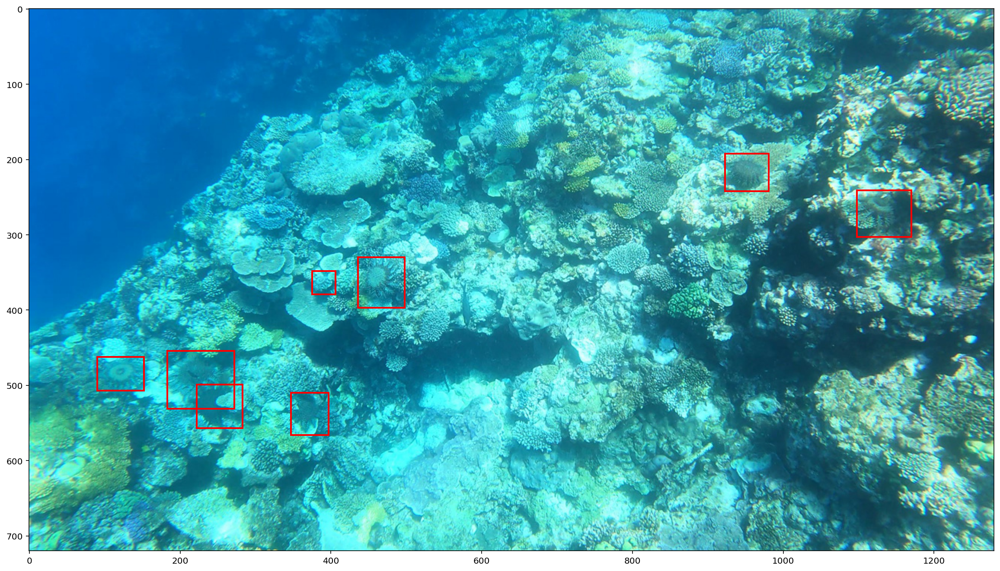

In [33]:
ix = 19724
img_w = 1280
img_h = 720
image_path = df.loc[ix, "img_path"]
annotations = df.loc[ix, "annotations"]
img = np.array(Image.open(image_path))
bboxes = np.zeros([len(annotations), 5])
for i in range(len(annotations)):
    xmin = annotations[i]["x"] / img_w
    ymin = annotations[i]["y"] / img_h
    width = annotations[i]["width"] / img_w
    height = annotations[i]["height"] / img_h
    width = width if (width + xmin) <= 1 else (1 - xmin)
    height = height if (height + ymin) <= 1 else (1 - ymin)
    x_center = xmin + width / 2
    y_center = ymin + height / 2
    bbox = " ".join(map(str, [0, x_center, y_center, width, height]))
    bboxes[i:, 0] = 0
    bboxes[i:, 1] = x_center
    bboxes[i:, 2] = y_center
    bboxes[i:, 3] = width
    bboxes[i:, 4] = height
plot_bboxes(img, annotations)

## experiments

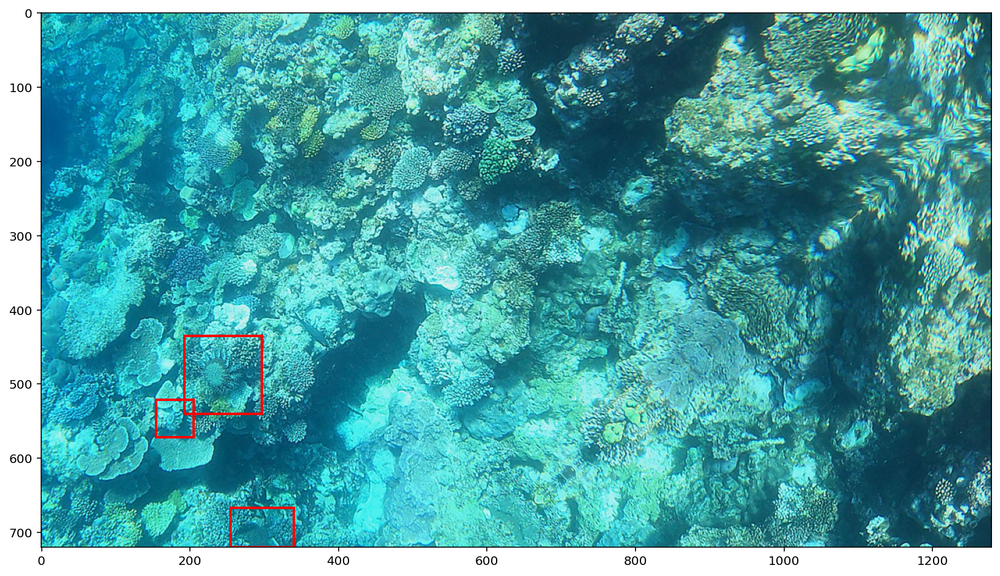

In [34]:
transform = A.Compose(
    [
        A.Blur(blur_limit=3, p=0.05),
        A.MedianBlur(blur_limit=3, p=0.05),
        A.ToGray(p=0.01),
        A.RandomBrightnessContrast(
            brightness_limit=0.05, contrast_limit=0.05, brightness_by_max=True, p=0.1
        ),
        A.RandomGamma(p=0.05),
        A.ImageCompression(quality_lower=95, p=0.05),
        A.Sharpen(alpha=(0.2, 0.3), lightness=(0.5, 1.0), p=0.05),
        A.HueSaturationValue(
            hue_shift_limit=10, sat_shift_limit=10, val_shift_limit=10, p=0.01
        ),
        A.RGBShift(p=0.01),
        A.Flip(p=0.01),
        A.ShiftScaleRotate(
            shift_limit=0.2, scale_limit=[0.1, 0.2], rotate_limit=[10, 45], p=1.0
        ),
        A.RandomRain(
            slant_lower=-10,
            slant_upper=10,
            drop_length=20,
            drop_width=1,
            drop_color=(200, 200, 200),
            blur_value=7,
            brightness_coefficient=0.6,
            rain_type="drizzle",
            p=0.01,
        ),
    ],
    bbox_params=A.BboxParams(
        format="yolo", min_visibility=0.5, label_fields=["class_labels"]
    ),
)
transformed = transform(
    image=img,
    bboxes=bboxes[:, 1:],
    class_labels=bboxes[:, 0],
)
a_img, a_bbox = transformed["image"], transformed["bboxes"]
show_img(a_img, a_bbox)

## default Yolov5 Albumentations

In [35]:
#default
# transform = A.Compose(
#     [
#         A.Blur(p=0.01),
#         A.MedianBlur(p=0.01),
#         A.ToGray(p=0.01),
#         A.CLAHE(p=0.01),
#         A.RandomBrightnessContrast(p=0.0),
#         A.RandomGamma(p=0.0),
#         A.ImageCompression(quality_lower=75, p=0.0),
#     ],
#     bbox_params=A.BboxParams(format="yolo", label_fields=["class_labels"]),
# )

transform = A.Compose(
    [
        A.Blur(blur_limit=3, p=0.01),
        A.MedianBlur(blur_limit=3, p=0.01),
        A.ToGray(p=0.01),
        A.RandomBrightnessContrast(
            brightness_limit=0.05, contrast_limit=0.05, brightness_by_max=True, p=0.1
        ),
        A.RandomGamma(p=0.05),
        A.ImageCompression(quality_lower=95, p=0.05),
        A.Sharpen(alpha=(0.2, 0.3), lightness=(0.5, 1.0), p=0.05),
        A.HueSaturationValue(
            hue_shift_limit=5, sat_shift_limit=5, val_shift_limit=5, p=0.01
        ),
        A.RGBShift(p=0.01),
        A.Flip(p=0.01),
        A.ShiftScaleRotate(
            shift_limit=0.2, scale_limit=[0.1, 0.2], rotate_limit=[10, 45], p=0.01
        ),
        A.RandomRain(
            slant_lower=-10,
            slant_upper=10,
            drop_length=20,
            drop_width=1,
            drop_color=(200, 200, 200),
            blur_value=7,
            brightness_coefficient=0.6,
            rain_type="drizzle",
            p=0.01,
        ),
    ],
    bbox_params=A.BboxParams(
        format="yolo", min_visibility=0.5, label_fields=["class_labels"]
    ),
)

## augmented dataset

In [36]:
transform = A.Compose(
    [
        A.ShiftScaleRotate(
            shift_limit=0.2, scale_limit=[0.1, 0.2], rotate_limit=45, p=1.0
        ),
        A.HueSaturationValue(
            hue_shift_limit=3, sat_shift_limit=3, val_shift_limit=5, p=1
        ),
        A.RandomBrightnessContrast(
            brightness_limit=0.01, contrast_limit=0.05, brightness_by_max=True, p=1
        ),
    ],
    bbox_params=A.BboxParams(
        format="yolo", min_visibility=0.5, label_fields=["class_labels"]
    ),
)

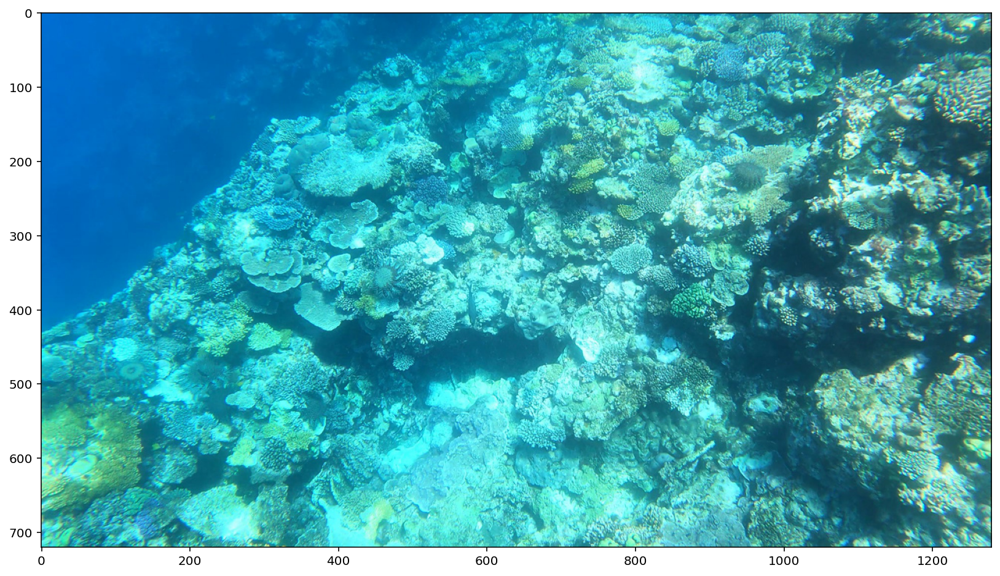

transformed variant = 0


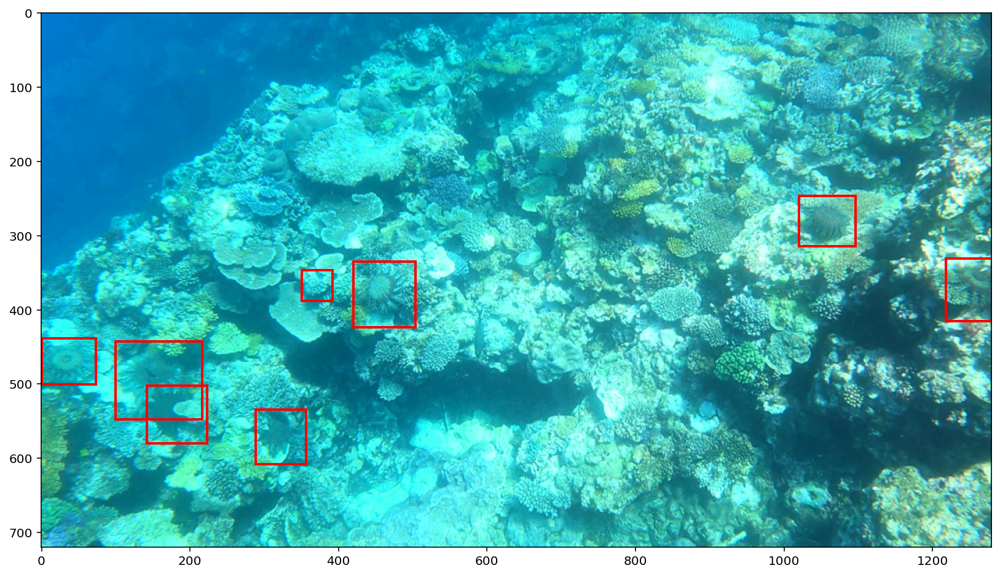

transformed variant = 1


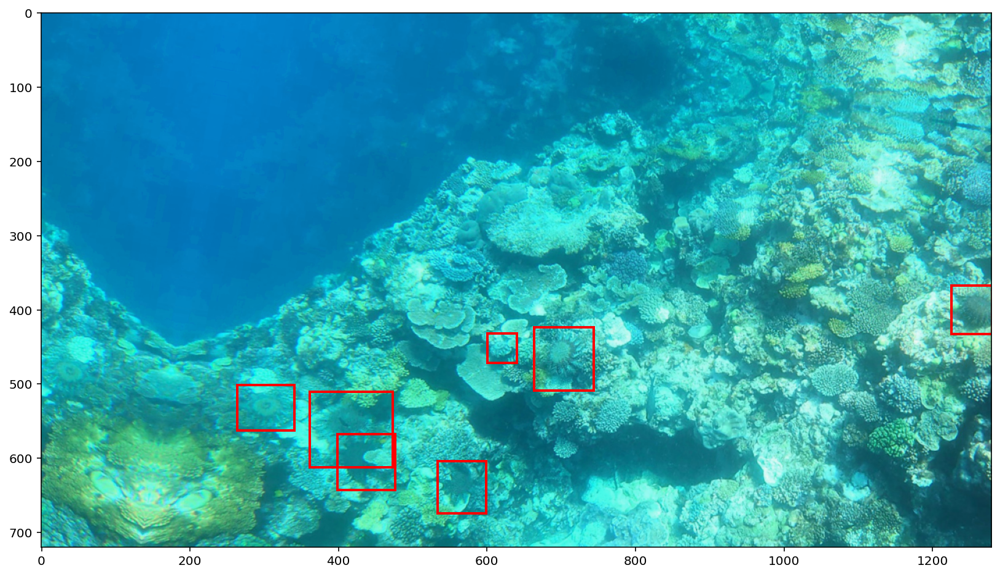

In [37]:
plt.figure(figsize=(15, 8))
plt.imshow(img)
plt.show()

for n in range(2):
    transformed = transform(
        image=img,
        bboxes=bboxes[:, 1:],
        class_labels=bboxes[:, 0],
    )
    print(f"transformed variant = {n}")
    a_img, a_bbox = transformed["image"], transformed["bboxes"]
    show_img(a_img, a_bbox)
plt.show();

In [38]:
# img_w = 1280
# img_h = 720
# df0 = df.copy()
# for ix in tqdm(df.index):
#     image_path = df.loc[ix, "img_path"]
#     img_name = df.loc[ix, "image_id"]
#     new_img_path = f"/app/_data/augmented/images/{img_name}.jpg"
#     df.loc[ix, "new_img_path"] = new_img_path
#     shutil.copy(image_path, new_img_path)
#     annotations = df.loc[ix, "annotations"]
#     if len(annotations):
#         with open(f"/app/_data/augmented/labels/{img_name}.txt", "w+") as f:
#             bboxes = np.zeros([len(annotations), 5])
#             for i in range(len(annotations)):
#                 xmin = annotations[i]["x"] / img_w
#                 ymin = annotations[i]["y"] / img_h
#                 width = annotations[i]["width"] / img_w
#                 height = annotations[i]["height"] / img_h
#                 width = width if (width + xmin) <= 1 else (1 - xmin)
#                 height = height if (height + ymin) <= 1 else (1 - ymin)
#                 x_center = xmin + width / 2
#                 y_center = ymin + height / 2
#                 bbox = " ".join(map(str, [0, x_center, y_center, width, height]))
#                 bboxes[i:, 0] = 0
#                 bboxes[i:, 1] = x_center
#                 bboxes[i:, 2] = y_center
#                 bboxes[i:, 3] = width
#                 bboxes[i:, 4] = height
#                 f.write(bbox)
#                 f.write("\n")
#         img = np.array(Image.open(image_path))
#         #         plt.figure(figsize=(15, 8))
#         #         plt.imshow(img)
#         #         plt.show()
#         for n in range(3):
#             transformed = transform(
#                 image=img,
#                 bboxes=bboxes[:, 1:],
#                 class_labels=bboxes[:, 0],
#             )
#             a_img, a_bbox = transformed["image"], transformed["bboxes"]
#             if len(a_bbox):
#                 row = pd.Series(df.loc[ix, :])
#                 new_boxes = []
#                 ws, hs = [], []
#                 aug_name = f"{img_name}_{n}"
#                 aug_path = f"/app/_data/augmented/images/{aug_name}.jpg"
#                 with open(f"/app/_data/augmented/labels/{aug_name}.txt", "w+") as f:
#                     for j in range(len(a_bbox)):
#                         x_c, y_c, w, h = a_bbox[j]
#                         bbox = " ".join(map(str, [0, x_c, y_c, w, h]))
#                         f.write(bbox)
#                         f.write("\n")
#                         xmin = int((x_c - w / 2) * img_w)
#                         ymin = int((y_c - h / 2) * img_h)
#                         w = int(w * img_w)
#                         h = int(img_h * h)
#                         ws.append(w)
#                         hs.append(h)
#                         new_boxes.append([xmin, ymin, w, h])
#                     row["bbox"] = new_boxes
#                     row["len_annotation"] = len(new_boxes)
#                     row["annotations"] = []
#                     row["new_img_path"] = aug_path
#                     row["image_id"] = aug_name
#                     row["width_max"] = np.max(ws)
#                     row["width_min"] = np.min(ws)
#                     row["height_max"] = np.max(hs)
#                     row["height_min"] = np.min(hs)
#                     row["width_mean"] = np.mean(ws)
#                     row["height_mean"] = np.mean(hs)
#                     df0 = df0.append(row, ignore_index=True)
#                     a_img = Image.fromarray(a_img)
#                     a_img.save(aug_path)
#     #                     show_img(a_img, a_bbox)
#     clear_output()
# df0.to_csv("/app/_data/train_alb.csv", index=False)

In [39]:
len(glob.glob("/app/_data/augmented/images/*.*"))
len(glob.glob("/app/_data/augmented/labels/*.*"))

38243

19661

In [40]:
df0 = pd.read_csv("/app/_data/train_alb.csv")
df0.tail(3)

,video_id,sequence,video_frame,sequence_frame,image_id,annotations,img_path,len_annotation,new_img_path,label,width_max,width_min,height_max,height_min,width_mean,height_mean,bbox
38232,2,29859,10632,2860,2_10632_0,[],/app/_data/tensorflow-great-barrier-reef/train...,1,/app/_data/augmented/images/2_10632_0.jpg,1,45.0,45.0,37.0,37.0,45.0,37.0,"[[38, 681, 45, 37]]"
38233,2,29859,10632,2860,2_10632_1,[],/app/_data/tensorflow-great-barrier-reef/train...,1,/app/_data/augmented/images/2_10632_1.jpg,1,45.0,45.0,37.0,37.0,45.0,37.0,"[[38, 681, 45, 37]]"
38234,2,29859,10632,2860,2_10632_2,[],/app/_data/tensorflow-great-barrier-reef/train...,1,/app/_data/augmented/images/2_10632_2.jpg,1,45.0,45.0,37.0,37.0,45.0,37.0,"[[38, 681, 45, 37]]"


# npy 380x380 for classification

In [41]:
def show_img(img, bbox):
    fig, ax = plt.subplots(1, 1, figsize=(15, 8))
    ax.imshow(img)
    for i in range(len(bbox)):
        xmin, ymin, xmax, ymax = bbox[i]
        rect = plt.Rectangle(
            [xmin, ymin],
            xmax-xmin,
            ymax-ymin,
            ec="r",
            fc="none",
            lw=2.0,
        )
        ax.add_patch(rect)
    plt.show();

In [42]:
coord = [
    [[0, 380], [0, 380]],
    [[0, 380], [300, 680]],
    [[0, 380], [600, 980]],
    [[0, 380], [900, 1280]],
    [[340, 720], [0, 380]],
    [[340, 720], [300, 680]],
    [[340, 720], [600, 980]],
    [[340, 720], [900, 1280]],
]

## example

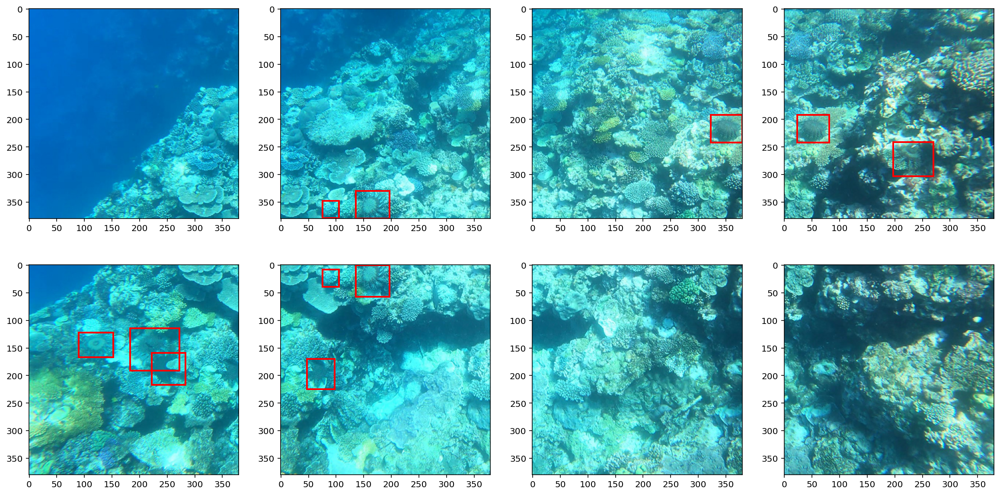

In [43]:
img_path = df.loc[19724, "img_path"]
img = np.array(Image.open(img_path))
annotations = np.array([list(x.values()) for x in df.loc[ix, "annotations"]])
if annotations.size:
    bboxes = np.zeros([len(annotations), 5])
    annotations[:,2] = annotations[:,2]+annotations[:,0]
    annotations[:,3] = annotations[:,3]+annotations[:,1]
    annotations[:,0] = np.clip(annotations[:,0], 0, 1279)
    annotations[:,1] = np.clip(annotations[:,1], 0, 719)
    annotations[:,2] = np.clip(annotations[:,2], 0, 1279)
    annotations[:,3] = np.clip(annotations[:,3], 0, 719)
    bboxes[:, 0] = 0
    bboxes[:, 1:] = annotations
    fig, axs = plt.subplots(2, 4, figsize=(20, 10))
    for ax, (y, x) in zip(axs.flatten(), coord):
        transform = A.Compose(
            [
                A.augmentations.crops.transforms.Crop(
                    x_min=x[0],
                    y_min=y[0],
                    x_max=x[1],
                    y_max=y[1],
                    p=1.0,
                )
            ],
            bbox_params=A.BboxParams(
                format="pascal_voc", min_visibility=0.7, label_fields=["class_labels"]
            ),
        )
        transformed = transform(
            image=img,
            bboxes=bboxes[:, 1:],
            class_labels=bboxes[:, 0],
        )
        a_img, a_bbox = transformed["image"], transformed["bboxes"]
        a_bbox = [list(map(int, x)) for x in a_bbox]
        ax.imshow(a_img)
        for i in range(len(a_bbox)):
            xmin, ymin, xmax, ymax = a_bbox[i]
            rect = plt.Rectangle(
                [xmin, ymin],
                xmax-xmin,
                ymax-ymin,
                ec="r",
                fc="none",
                lw=2.0,
            )
            ax.add_patch(rect)
plt.show();

In [44]:
# cut_df = pd.DataFrame(
#     columns=["image_id", "new_img_id", "label", "bboxes", "n_bboxes", "npy_path"]
# )
# for ix in tqdm(df.index.tolist()):

#     img_path = df.loc[ix, "img_path"]
#     img_name = df.loc[ix, "image_id"]
#     img = np.array(Image.open(img_path))
#     annotations = np.array([list(x.values()) for x in df.loc[ix, "annotations"]])
#     if annotations.size:
#         bboxes = np.zeros([len(annotations), 5])
#         annotations[:,2] = annotations[:,2]+annotations[:,0]
#         annotations[:,3] = annotations[:,3]+annotations[:,1]
#         annotations[:,0] = np.clip(annotations[:,0], 0, 1279)
#         annotations[:,1] = np.clip(annotations[:,1], 0, 719)
#         annotations[:,2] = np.clip(annotations[:,2], 0, 1279)
#         annotations[:,3] = np.clip(annotations[:,3], 0, 719)
#         bboxes[:, 0] = 0
#         bboxes[:, 1:] = annotations
#         for n, (y, x) in enumerate(coord):
#             transform = A.Compose(
#                 [
#                     A.augmentations.crops.transforms.Crop(
#                         x_min=x[0],
#                         y_min=y[0],
#                         x_max=x[1],
#                         y_max=y[1],
#                         p=1.0,
#                     )
#                 ],
#                 bbox_params=A.BboxParams(
#                     format="pascal_voc", min_visibility=0.7, label_fields=["class_labels"]
#                 ),
#             )
#             transformed = transform(
#                 image=img,
#                 bboxes=bboxes[:, 1:],
#                 class_labels=bboxes[:, 0],
#             )
#             a_img, a_bbox = transformed["image"], transformed["bboxes"]
#             a_bbox = [list(map(int, x)) for x in a_bbox]
#             if len(a_bbox):
# #                 show_img(a_img, a_bbox)
#                 new_img_name = f"{img_name}_{n}"
#                 label = 1
#                 np.save(f"/app/_data/npy_380/{new_img_name}", a_img)
#                 cut_df = cut_df.append(
#                     {
#                         "image_id": img_name,
#                         "new_img_id": new_img_name,
#                         "label": label,
#                         "bboxes": " ".join(
#                             [" ".join(list(map(str, x))) for x in a_bbox]
#                         ),
#                         "n_bboxes": len(a_bbox),
#                         "npy_path": f"/app/_data/npy_380/{new_img_name}.npy",
#                     },
#                     ignore_index=True,
#                 )
#     else:
#         for n, (y, x) in enumerate(coord):
#             transform = A.Compose(
#                 [
#                     A.augmentations.crops.transforms.Crop(
#                         x_min=x[0],
#                         y_min=y[0],
#                         x_max=x[1],
#                         y_max=y[1],
#                         p=1.0,
#                     )
#                 ],
#             )
#             a_img = transform(
#                 image=img,
#             )["image"]
#             new_img_name = f"{img_name}_{n}"
#             label = 0
#             np.save(f"/app/_data/npy_380/{new_img_name}", a_img)
#             cut_df = cut_df.append(
#                 {
#                     "image_id": img_name,
#                     "new_img_id": new_img_name,
#                     "label": label,
#                     "bboxes": "",
#                     "n_bboxes": 0,
#                     "npy_path": f"/app/_data/npy_380/{new_img_name}.npy",
#                 },
#                 ignore_index=True,
#             )
# # cut_df.to_csv('/app/_data/cut_df.csv', index=False)

In [45]:
cut_df = pd.read_csv('/app/_data/cut_df.csv')
cut_df.sample(10)

,image_id,new_img_id,label,bboxes,n_bboxes,npy_path
145307,2_9128,2_9128_0,0,NaN,0,/app/_data/npy_380/2_9128_0.npy
75329,1_8655,1_8655_0,0,NaN,0,/app/_data/npy_380/1_8655_0.npy
105499,2_1488,2_1488_0,0,NaN,0,/app/_data/npy_380/2_1488_0.npy
73085,1_6663,1_6663_0,0,NaN,0,/app/_data/npy_380/1_6663_0.npy
157332,2_10643,2_10643_1,0,NaN,0,/app/_data/npy_380/2_10643_1.npy
76264,1_8794,1_8794_5,0,NaN,0,/app/_data/npy_380/1_8794_5.npy
70011,1_6214,1_6214_7,0,NaN,0,/app/_data/npy_380/1_6214_7.npy
7987,0_1972,0_1972_7,0,NaN,0,/app/_data/npy_380/0_1972_7.npy
80074,1_9684,1_9684_7,0,NaN,0,/app/_data/npy_380/1_9684_7.npy
10068,0_2233,0_2233_0,0,NaN,0,/app/_data/npy_380/0_2233_0.npy
